# **Assignment 2**


###**Part 4: Python GeoPandas & Part 6: K-Means -- DBSCAN-clustering**

Part 4: Python GeoPandas

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
pip install geopandas fiona shapely pyproj rtree contextily folium matplotlib mapclassify

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 488.6/488.6 kB 7.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 20.6/20.6 MB 71.1 MB/s eta 0:00:00


In [4]:
pip install contextily

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 20.6/20.6 MB 59.7 MB/s eta 0:00:00


In [ ]:
pip install mapclassify

The three coding lines above install packages needed for this portion of the assignment.

In [ ]:
import geopandas as gpd

The code above installs the geopandas library and abbreviates it as gpd for reference later on.

In [ ]:
geo = gpd.read_file('/content/drive/MyDrive/Colab Notebooks/Geomorphology_of_the_Cairngorm_Mountains/Cairngorm_Geomorphology_Polygons.shp')

The code above reads the data as a GeoPandas dataframe and names it geo.

In [ ]:
geo.head()

,OBJECTID,PRIMARY_CO,SECONDARY_,LANDFORM_A,LANDFORM,OID_T,SHAPE_Leng,SHAPE_Area,geometry
0,1,3.6,None,Landforms of glacial and glaciofluvial deposition,Moraine,73.0,421.809778,12177.266399,"POLYGON ((300032.000 808286.875, 300013.094 80..."
1,2,4.2a,None,Landforms of glacial and glaciofluvial deposition,Ice-marginal kame,74.0,1238.740991,38663.205669,"POLYGON ((302113.637 807965.677, 302017.690 80..."
2,3,3.6,None,Landforms of glacial and glaciofluvial deposition,Moraine,75.0,379.218579,8761.285828,"POLYGON ((299794.813 808279.875, 299772.188 80..."
3,4,3.7,None,Landforms of glacial and glaciofluvial deposition,Moraine limit,76.0,209.893525,2567.092477,"POLYGON ((302992.094 808222.625, 302982.094 80..."
4,5,3.6,None,Landforms of glacial and glaciofluvial deposition,Moraine,77.0,733.168468,23406.109899,"POLYGON ((299896.313 807991.188, 299879.000 80..."


The code above reads the first 5 rows in the dataframe by using the .head() function.

In [ ]:
geo.tail()

,OBJECTID,PRIMARY_CO,SECONDARY_,LANDFORM_A,LANDFORM,OID_T,SHAPE_Leng,SHAPE_Area,geometry
4110,4111,3.9,None,Landforms of glacial and glaciofluvial deposition,Undifferentiated ice-marginal deposits,3511.0,373.447812,7275.422445,"POLYGON ((318827.454 805089.378, 318834.438 80..."
4111,4112,3.9,None,Landforms of glacial and glaciofluvial deposition,Undifferentiated ice-marginal deposits,3512.0,317.786136,6743.949450,"POLYGON ((318871.814 804756.656, 318857.266 80..."
4112,4113,3.9,None,Landforms of glacial and glaciofluvial deposition,Undifferentiated ice-marginal deposits,3513.0,173.746256,1870.449243,"POLYGON ((318930.850 804839.005, 318929.104 80..."
4113,4114,3.9,None,Landforms of glacial and glaciofluvial deposition,Undifferentiated ice-marginal deposits,3514.0,250.148919,4686.949632,"POLYGON ((318927.940 804809.326, 318929.104 80..."
4114,4115,3.9,None,Landforms of glacial and glaciofluvial deposition,Undifferentiated ice-marginal deposits,3515.0,246.187382,4463.609221,"POLYGON ((318754.831 804695.894, 318747.012 80..."


The code above reads the last 5 rows of the dataframe by using the .tail() function.

In [ ]:
geo.explore()

The code above allows the user to explore the dataset, where if you hover your mouse above a polygon, its attributes will be shown.

In [ ]:
geo.explore(column='LANDFORM_A')

The code above also explores the dataframe but color codes it so that a specific categorical attribute (LANDFORM_A) is differentiated. The legend shows what each color represents.

In [ ]:
geo.crs

<Projected CRS: EPSG:27700>
Name: OSGB36 / British National Grid
Axis Info [cartesian]:
- E[east]: Easting (metre)
- N[north]: Northing (metre)
Area of Use:
- name: United Kingdom (UK) - offshore to boundary of UKCS within 49°45'N to 61°N and 9°W to 2°E; onshore Great Britain (England, Wales and Scotland). Isle of Man onshore.
- bounds: (-9.01, 49.75, 2.01, 61.01)
Coordinate Operation:
- name: British National Grid
- method: Transverse Mercator
Datum: Ordnance Survey of Great Britain 1936
- Ellipsoid: Airy 1830
- Prime Meridian: Greenwich

The code above returns the reference system of the dataframe, which is EPSG:27700.

In [ ]:
geo.shape

(4115, 9)

The code above returns the number of rows and columns of the dataframe by using the .shape function. There are 4,115 features in this dataframe.

In [ ]:
geo_gdf1 = geo[['LANDFORM', 'SHAPE_Leng', 'SHAPE_Area', 'geometry']]
index_geo = geo_gdf1['LANDFORM'] == 'Moraine'
geo_gdf1 = geo_gdf1[index_geo]
geo_gdf1

,LANDFORM,SHAPE_Leng,SHAPE_Area,geometry
0,Moraine,421.809778,12177.266399,"POLYGON ((300032.000 808286.875, 300013.094 80..."
2,Moraine,379.218579,8761.285828,"POLYGON ((299794.813 808279.875, 299772.188 80..."
4,Moraine,733.168468,23406.109899,"POLYGON ((299896.313 807991.188, 299879.000 80..."
8,Moraine,489.418707,16322.023313,"POLYGON ((299740.501 808021.188, 299732.500 80..."
9,Moraine,202.198275,2383.683266,"POLYGON ((299343.594 808079.187, 299313.594 80..."
...,...,...,...,...
3994,Moraine,194.125504,2706.202105,"POLYGON ((314617.352 804358.165, 314627.281 80..."
4018,Moraine,143.243609,1265.087589,"POLYGON ((315809.870 805833.874, 315796.485 80..."
4019,Moraine,123.729715,1152.506524,"POLYGON ((315794.011 805759.238, 315787.901 80..."
4020,Moraine,161.015394,1334.167957,"POLYGON ((315459.775 805922.664, 315449.300 80..."


The code above creates a subset of the dataframe called "geo_gdf1". In this contains the columns 'LANDFORM', 'SHAPE_Leng', 'SHAPE_Area', and'geometry'. Of this subsetted dataframe, another subset is created just containing rows that have moraines as the landform type. This resulted in 999 features in this new dataframe.

In [ ]:
geo_gdf2 = geo[['PRIMARY_CO', 'SHAPE_Leng', 'SHAPE_Area', 'geometry']]
index_geo = geo_gdf2['SHAPE_Area'] > 8000
geo_gdf2 = geo_gdf2[index_geo]
geo_gdf2

,PRIMARY_CO,SHAPE_Leng,SHAPE_Area,geometry
0,3.6,421.809778,12177.266399,"POLYGON ((300032.000 808286.875, 300013.094 80..."
1,4.2a,1238.740991,38663.205669,"POLYGON ((302113.637 807965.677, 302017.690 80..."
2,3.6,379.218579,8761.285828,"POLYGON ((299794.813 808279.875, 299772.188 80..."
4,3.6,733.168468,23406.109899,"POLYGON ((299896.313 807991.188, 299879.000 80..."
7,4.3,837.058222,14679.395048,"POLYGON ((294938.499 807858.313, 294926.095 80..."
...,...,...,...,...
4086,3.9,496.554455,12554.705533,"POLYGON ((318654.464 802593.679, 318647.566 80..."
4088,3.9,511.520515,12329.956879,"POLYGON ((318577.813 802618.035, 318572.152 80..."
4096,3.9,414.710790,9899.385320,"POLYGON ((308776.577 806713.024, 308767.332 80..."
4097,3.9,471.559254,12721.869694,"POLYGON ((308880.249 806650.245, 308866.737 80..."


The code above creates another subset (called geo_gdf2) of the original data where the columns that were selected to be in this were 'PRIMARY_CO', 'SHAPE_Leng', 'SHAPE_Area', and 'geometry'. Of this, a numerical attribute was chosen to be subsetted- having an area greater than 8,000, so another subset of the data was created with this condition. This resulted in 1,846 features in this new dataframe.

<Axes: >

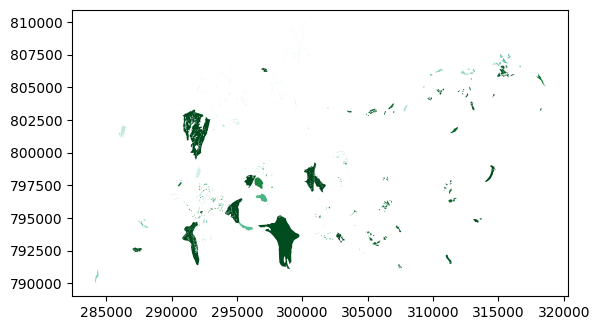

In [ ]:
geo_gdf1.plot(cmap="BuGn")

The code above plots the subsetted data categorical data containing information on moraines. The plot shows where moraines are located in the Cairngorm Mountains.

Part 6: K-Means -- DBSCAN-clustering

In [5]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import geopandas as gpd
import contextily as ctx
import rasterio as rio
from rasterio import plot
import seaborn as sns

plt.rcParams['figure.figsize'] = [10, 8]

import zipfile
import os

The cell above imports libraries.

**T1**

In [6]:
chi = gpd.read_file('/content/drive/MyDrive/Colab Notebooks/chicago_parcels')

The cell above reads the data and names it "chi".

**T2**

In [ ]:
chi.head(5)

,POLY_ID,ID,AREA,PIN_OLD,PIN,geometry
0,1,93,0.01,836300010,836300010,"POLYGON ((1091182.694 1942890.287, 1091173.159..."
1,2,94,0.00,836300011,836300011,"POLYGON ((1092430.298 1943191.955, 1092463.452..."
2,3,96,0.02,836300013,836300013,"POLYGON ((1092323.996 1942962.610, 1092301.306..."
3,4,95,0.01,836300012,836300012,"POLYGON ((1092024.119 1942447.762, 1091997.190..."
4,5,92,0.01,836300009,836300009,"POLYGON ((1091970.533 1942338.191, 1091929.082..."


The cell above reads the first few rows of the dataset.

In [ ]:
geo = chi["geometry"]
geo.head()

0    POLYGON ((1091182.694 1942890.287, 1091173.159...
1    POLYGON ((1092430.298 1943191.955, 1092463.452...
2    POLYGON ((1092323.996 1942962.610, 1092301.306...
3    POLYGON ((1092024.119 1942447.762, 1091997.190...
4    POLYGON ((1091970.533 1942338.191, 1091929.082...
Name: geometry, dtype: geometry

**T3**

In [ ]:
pip install lonboard

In [ ]:
import geopandas as gpd
from lonboard import Map, SolidPolygonLayer
from sklearn.cluster import KMeans, DBSCAN
import matplotlib.pyplot as plt
import shapely
import folium
import seaborn as sns

In [ ]:
from lonboard import viz

The code cells above import the lonboard package and then loads mulitple libraries.

In [ ]:
viz(chi)

/usr/local/lib/python3.10/dist-packages/lonboard/_viz.py:156: UserWarning: GeoDataFrame being reprojected to EPSG:4326
  warnings.warn("GeoDataFrame being reprojected to EPSG:4326")


Map(layers=[SolidPolygonLayer(table=pyarrow.Table
POLY_ID: int64
ID: int64
AREA: double
PIN_OLD: int64
PIN: in…

The cell above creates a map of the tax parcel polygons using the viz() function.

**T4**

In [ ]:
chi.corr(method='pearson', min_periods=1, numeric_only=False)

TypeError: ignored

In [15]:
coordinates = chi["geometry"]
coordinates

0         POLYGON ((1091182.694 1942890.287, 1091173.159...
1         POLYGON ((1092430.298 1943191.955, 1092463.452...
2         POLYGON ((1092323.996 1942962.610, 1092301.306...
3         POLYGON ((1092024.119 1942447.762, 1091997.190...
4         POLYGON ((1091970.533 1942338.191, 1091929.082...
                                ...                        
592516    POLYGON ((1198269.792 1832592.793, 1198394.873...
592517    POLYGON ((1198410.986 1832594.443, 1198534.158...
592518    POLYGON ((1198602.435 1832596.186, 1198724.787...
592519    POLYGON ((1198742.539 1832597.464, 1198864.615...
592520    POLYGON ((1200507.677 1828359.399, 1200348.710...
Name: geometry, Length: 592521, dtype: geometry

The code above creates a correlation for the chi dataframe.

**T5**

In [7]:
def initialize_centroids(data, k):
    indices = np.random.choice(len(data), k, replace=False)
    centroids = data[indices]
    return centroids

In [16]:
def assign_clusters(data, centroids):
    distances = np.linalg.norm(data[:, np.newaxis] - centroids, axis=2)

    clusters = np.argmin(distances, axis=1)
    return clusters

In [9]:
def update_centroids(data, clusters, k):
    centroids = np.array([data[clusters == i].mean(axis=0) for i in range(k)])
    return centroids

In [17]:
def k_means(data, k, max_iterations=100):
    centroids = initialize_centroids(data, k)

    for iteration in range(max_iterations):
        clusters = assign_clusters(data, centroids)

        new_centroids = update_centroids(data, clusters, k)

        if np.all(centroids == new_centroids):
            break

        centroids = new_centroids

    return clusters, centroids

In [13]:
kmeans = KMeans(n_clusters=5, random_state=42)
chi['kmeans_cluster'] = kmeans.fit_predict(chi)

NameError: ignored

The code above produces a k-means cluster with 5 clusters.

**T6**

**T7**

**T8**

In [ ]:
dbscan = DBSCAN(eps=0.8, min_samples=5)
chi['dbscan_cluster'] = dbscan.fit_predict(chi[['X', 'Y']])

KeyError: ignored

The code above implements DBSCAN clustering with an epsilon of 0.8 and a minimum of 5 samples.

**T9**

**T10**